# ABOUT THE DATASET #

The Aquarium Dataset was downloaded from Roboflow, which provides a variety of datasets formatted for different machine learning frameworks.

1)  First, the dataset was downloaded directly from Roboflow in the COCO format by selecting the appropriate export option.

2) The downloaded dataset was checked to ensure that it contained the COCO annotations, along with image files.

3) The dataset was organized into folders (train, valid, and test) with corresponding annotation files located in each folder.

I haven't used any code to convert the dataset into COCO format, the dataset was already available in COCO format for download

# MODEL SELECTION #
1) The model selected is rtmdet_tiny_8xb32-300e_coco from the MMDetection model zoo.

2) RTMDet_tiny is a lightweight model designed for efficient object detection tasks, making it suitable for scenarios where computational resources may be limited.

3) It balances performance and speed, making it ideal for detecting relatively simple objects in moderately sized datasets like the Aquarium Dataset

In [2]:
!mkdir /checkpoints/rtmdet
!mim download mmdet --config rtmdet_tiny_8xb32-300e_coco --dest /checkpoints/rtmdet

The syntax of the command is incorrect.


processing rtmdet_tiny_8xb32-300e_coco...
rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth exists in c:\checkpoints\rtmdet
Successfully dumped rtmdet_tiny_8xb32-300e_coco.py to c:\checkpoints\rtmdet


processing rtmdet_tiny_8xb32-300e_coco...
downloading ---------------------------------------- 0.0/54.9 MiB ? eta -:--:--
downloading ---------------------------------------- 0.0/54.9 MiB ? eta -:--:--
downloading ------------------------------- 0.1/54.9 MiB 675.4 kB/s eta 0:01:26
downloading ------------------------------- 0.1/54.9 MiB 675.4 kB/s eta 0:01:26
downloading ------------------------------- 0.1/54.9 MiB 424.9 kB/s eta 0:02:16
downloading ------------------------------- 0.1/54.9 MiB 424.9 kB/s eta 0:02:16
downloading ------------------------------- 0.1/54.9 MiB 459.2 kB/s eta 0:02:06
downloading ------------------------------- 0.1/54.9 MiB 464.6 kB/s eta 0:02:04
downloading ------------------------------- 0.1/54.9 MiB 464.6 kB/s eta 0:02:04
downloading ------------------------------- 0.2/54.9 MiB 497.6 kB/s eta 0:01:56
downloading ------------------------------- 0.2/54.9 MiB 501.8 kB/s eta 0:01:55
downloading ------------------------------- 0.2/54.9 MiB 472.3 kB/s eta 0:02:0

In [3]:
from mmdet.apis import DetInferencer

# Choose to use a config
model_name = 'rtmdet_tiny_8xb32-300e_coco'
# Setup a checkpoint file to load
checkpoint = 'C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(model_name, checkpoint, device)

# Use the detector to do inference
img = 'C:/projects/marine_detection/dataset/test/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg'
result = inferencer(img, out_dir='./output')

Loads checkpoint by local backend from path: C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth
The model and loaded state dict do not match exactly

unexpected key in source state_dict: data_preprocessor.mean, data_preprocessor.std

09/09 23:21:10 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.


Output()

c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\mmengine\visualization\visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed 
with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: 
CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at 
C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,

c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\functional.py:512: UserWarning: torch.meshgrid: in 
an upcoming release, it will be required to pass the indexing argument. (Triggered internally at 
C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3588.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]

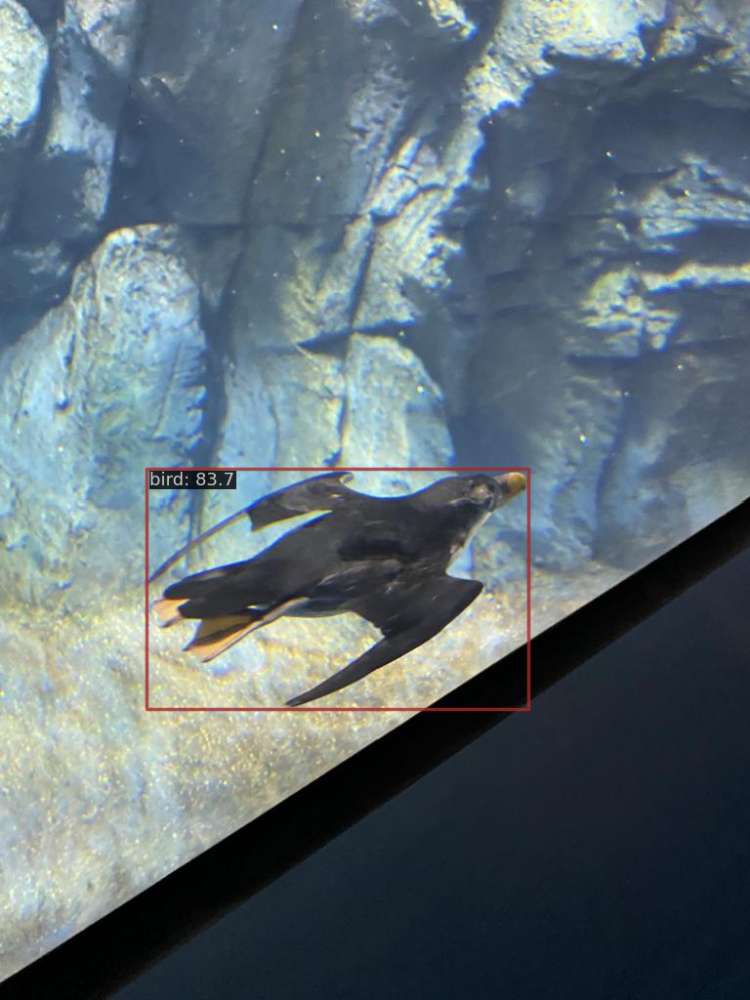

In [4]:
from PIL import Image
Image.open('C:/projects/marine_detection/output/vis/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg')

In [4]:
from rich.pretty import pprint
pprint(result, max_length=4)

{
│   'predictions': [
│   │   {
│   │   │   'labels': [14, 14, 14, 14, ... +296],
│   │   │   'scores': [0.8370267152786255, 0.1972648650407791, 0.1757483035326004, 0.1515635997056961, ... +296],
│   │   │   'bboxes': [
│   │   │   │   [150.4775390625, 479.5104675292969, 541.2382202148438, 726.1522827148438],
│   │   │   │   [286.5552673339844, 584.4472045898438, 512.8187866210938, 725.8486938476562],
│   │   │   │   [148.4721221923828, 474.4264831542969, 369.5365295410156, 597.307373046875],
│   │   │   │   [150.8612823486328, 476.10723876953125, 383.94769287109375, 685.6046752929688],
│   │   │   │   ... +296
│   │   │   ]
│   │   }
│   ],
│   'visualization': [
│   │   array([[[185, 221, 235],
│   │   [177, 213, 225],
│   │   [167, 201, 213],
│   │   ...,
│   │   [122, 127, 133],
│   │   [122, 125, 130],
│   │   [120, 123, 128]],
│      
│      [[181, 214, 233],
│   │   [171, 204, 223],
│   │   [157, 190, 207],
│   │   ...,
│   │   [122, 127, 133],
│   │   [122, 125, 130],
│   │   [121, 124, 129]],
│      
│      [[172, 202, 226],
│   │   [164, 194, 218],
│   │   [153, 184, 205],
│   │   ...,
│   │   [122, 129, 135],
│   │   [124, 129, 133],
│   │   [123, 128, 132]],
│      
│      ...,
│      
│      [[  0,   2,   1],
│   │   [  0,   2,   1],
│   │   [  0,   2,   1],
│   │   ...,
│   │   [  8,  22,  35],
│   │   [  8,  22,  35],
│   │   [  8,  22,  35]],
│      
│      [[  0,   2,   1],
│   │   [  0,   2,   1],
│   │   [  0,   2,   1],
│   │   ...,
│   │   [  8,  22,  35],
│   │   [  8,  22,  35],
│   │   [  8,  22,  35]],
│      
│      [[  0,   2,   1],
│   │   [  0,   2,   1],
│   │   [  0,   2,   1],
│   │   ...,
│   │   [  8,  22,  35],
│   │   [  8,  22,  35],
│   │   [  8,  22,  35]]], dtype=uint8)
│   ]
}

# CONFIGURATION MODIFICATION #

1) Updated the model configuration (bbox_head) to reflect the 8 classes in the dataset

2) Updated Setting paths for the training, validation, and test datasets under train_dataloader, val_dataloader, and test_dataloader sections to point to the appropriate directories and annotation files.

3) Set a base learning rate of 0.001, which is generally a conservative start for fine-tuning pre-trained models 

base_lr=(default_lr × original total batch size) / your total batch size --> base_lr = (0.004 x 8) / 32 = 0.001

4) Adjusted batch size and number of workers (train_batch_size_per_gpu and train_num_workers) to balance training speed and memory usage based on available GPU resources.

5) For the augmented model (rtmdet_tiny_aug_aquarium), included augmentation techniques like RandomFlip and Normalize to improve model robustness.

# WHY THESE CHANGES #

1) Adapting the number of classes and paths ensures that the model learns specifically from the dataset at hand.

2) Adjusting parameters like learning rate and batch size are critical for achieving stable and efficient training. Augmentation helps increase the model's generalization ability.

In [4]:
config_aquarium = """
# Inherit and overwrite part of the config based on this config
_base_ = 'C:/projects/marine_detection/mmdetection/configs/rtmdet/rtmdet_tiny_8xb32-300e_coco.py'

data_root = 'C:/projects/marine_detection/dataset/' # dataset root

train_batch_size_per_gpu = 8
train_num_workers = 4

max_epochs = 100
base_lr = 0.001


metainfo = {
    'classes': ('creatures','fish','jellyfish','penguin','shark','puffin','stingray','starfish'),
    'palette': [
        (255, 0, 0),        #creatures
        (0, 255, 0),        # Fish
        (255, 105, 180),    # Jellyfish
        (0, 0, 255),        # Penguin
        (255, 165, 0),      # Shark
        (255, 192, 203),    # Puffin
        (128, 0, 128),      # Stingray
        (255, 215, 0),      # Starfish
    ]
}

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='C:/projects/marine_detection/dataset/train/'),
        ann_file=data_root+'train/_annotations.coco.json'))

val_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,

        data_prefix=dict(img='C:/projects/marine_detection/dataset/valid/'),
        ann_file=data_root+'valid/_annotations.coco.json'))

test_dataloader = val_dataloader

val_evaluator = dict(ann_file=data_root + 'valid/_annotations.coco.json')

test_evaluator = val_evaluator

model = dict(bbox_head=dict(num_classes=8))

# learning rate
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=10),
    dict(
        # use cosine lr from 10 to 20 epoch
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]

# optimizer
optim_wrapper = dict(
    _delete_=True,
    type='OptimWrapper',
    optimizer=dict(type='AdamW', lr=base_lr, weight_decay=0.05),
    paramwise_cfg=dict(
        norm_decay_mult=0, bias_decay_mult=0, bypass_duplicate=True))

default_hooks = dict(
    checkpoint=dict(
        interval=5,
        max_keep_ckpts=2,  # only keep latest 2 checkpoints
        save_best='auto'
    ),
    logger=dict(type='LoggerHook', interval=5),
    early_stopping=dict(
        type='EarlyStoppingHook',
        patience=10,  # Number of epochs with no improvement after which training will be stopped
        monitor='bbox_mAP',  # Metric to monitor
        priority=75
    )
)


# load COCO pre-trained weight
load_from = 'C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'

train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=max_epochs, val_interval=1)
visualizer = dict(vis_backends=[dict(type='LocalVisBackend'),dict(type='TensorboardVisBackend')])
"""

with open('C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_aquarium.py', 'w') as f:
    f.write(config_aquarium)

# TRAINING PROCESS #

1) The rtmdet_tiny model was chosen after initial attempts with larger models caused CUDA out-of-memory errors. This selection balanced model complexity with available resources.

2) Matching the config file to the model was essential since parameter differences could lead to training failures. Each model's architecture dictates its compatible configuration.

3) Selecting appropriate augmentations required balancing between enhancing the dataset's variability and matching the model's ability to learn from altered data without degrading performance.

# RESOLUTION #

1) Setting the batch_size as per GPU requirements.

2) Choosing the right model which is sufficient for the dataset.

3) Going through the MMDetection documentation to find the configuration file that aligns with the model's architecture.

4) Trial and error method for data augmentation ( to include and delete some steps for better model performance and no errors while training).

Run the command below in a code cell to start the training process:

In [ ]:
!python mmdetection/tools/train.py checkpoints/rtmdet/rtmdet_tiny_aquarium.py

# FINE-TUNING AND IMPROVEMENTS #

1) Two strategies for improving the model’s performance

- Data Augmentation : Data augmentation can significantly improve the model’s robustness and generalization by artificially increasing the diversity of the training data. For object detection, augmentations such as random cropping, scaling, rotation, or brightness adjustment can help the model learn better representations. Improves the model’s ability to generalize to new, unseen data by preventing overfitting to the training set.

- Hyperparameter Tuning : Hyperparameter tuning involves adjusting the training parameters to optimize the model’s performance. Proper tuning can lead to better convergence, stability, and overall performance of the model.Optimized hyperparameters can lead to faster convergence, reduced training time, and improved performance on the validation set.

2) Implementing Data Augmentation : Basic data augmentation techniques (resizing, random flip, normalization) were used, but more advanced augmentation strategies were not applied in this initial run. A comparison showed that the basic augmentations provided a good baseline, but further augmentation could yield additional gains.



# INFERENCE #

The trained model was run on a set of test images from the Aquarium Dataset, with results visualized using bounding boxes and class labels. This helped verify the model's detection capability in a practical setting.

In [ ]:
from mmdet.apis import DetInferencer
import glob
import os

# Choose to use a config
config = 'C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_aquarium.py'

# Setup a checkpoint file to load
checkpoint = glob.glob('C:/projects/marine_detection/work_dirs/rtmdet_tiny_aquarium/best_coco*.pth')[0]

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(config, checkpoint, device)

# Define the test images folder and output directory
test_images_folder = 'C:/projects/marine_detection/dataset/train/'
output_dir = 'C:/projects/marine_detection/test_results/rtmdet_tiny_aquarium/vis/train_inference'

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# Get all images from the test folder
image_paths = glob.glob(os.path.join(test_images_folder, '*.jpg'))  # Adjust the extension if needed (e.g., '*.png')

# Loop through each image and run inference
for img_path in image_paths:
    print(f'Processing {img_path}...')
    result = inferencer(img_path, out_dir=output_dir)

print("Inference complete for all test images.")

# CREATING .PKL FILE #

The results, typically including predicted bounding boxes, confidence scores, and labels, will be stored in a pickle file (results.pkl). This output can be further used for analysis, visualization, or performance evaluation.

In [5]:
!python C:/projects/marine_detection/mmdetection/tools/test.py \
    C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_aquarium.py \
    C:/projects/marine_detection/work_dirs/rtmdet_tiny_aquarium/best_coco_bbox_mAP_epoch_97.pth \
    --out C:/projects/marine_detection/work_dirs/rtmdet_tiny_aquarium/results.pkl \
    --show

09/08 21:57:14 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: win32
    Python: 3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 153889707
    GPU 0: NVIDIA GeForce GTX 1650 Ti
    CUDA_HOME: C:\Program Files\NVIDIA GPU Computing Toolkit\CUDA\v11.8
    NVCC: Cuda compilation tools, release 11.8, V11.8.89
    MSVC: Microsoft (R) C/C++ Optimizing Compiler Version 19.34.31937 for x64
    GCC: n/a
    PyTorch: 2.3.0
    PyTorch compiling details: PyTorch built with:
  - C++ Version: 201703
  - MSVC 192930151
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.3.6 (Git Hash 86e6af5974177e513fd3fee58425e1063e7f1361)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2
 

c:\projects\marine_detection\mmdetection\mmdet\engine\hooks\visualization_hook.py:68: UserWarning: The show is True, it means that only the prediction results are visualized without storing data, so vis_backends needs to be excluded.
  warnings.warn('The show is True, it means that only '
c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
c:\Users\sushe\.conda\envs\deeplearning\Lib\site-packages\torch\functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3588.)
  return _VF.mes

# CREATING CONFUSION MATRIX #

A confusion matrix is created to provide a detailed evaluation of the model's performance by showing the counts of true positives, false positives, false negatives, and true negatives for each class.

In [9]:
!python mmdetection/tools/analysis_tools/confusion_matrix.py \
  C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_aquarium.py \
  C:/projects/marine_detection/work_dirs/rtmdet_tiny_aquarium/results.pkl \
  C:/projects/marine_detection/test_results/rtmdet_tiny_aquarium/vis/confusion_matrix \
  --show --score-thr 0.5 --tp-iou-thr 0.5

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
[                                                  ] 0/127, elapsed: 0s, ETA:
[                               ] 1/127, 510.4 task/s, elapsed: 0s, ETA:     0s
[                               ] 2/127, 505.2 task/s, elapsed: 0s, ETA:     0s
[                               ] 3/127, 605.0 task/s, elapsed: 0s, ETA:     0s
[                               ] 4/127, 671.4 task/s, elapsed: 0s, ETA:     0s
[>                              ] 5/127, 628.2 task/s, elapsed: 0s, ETA:     0s
[>                              ] 6/127, 600.3 task/s, elapsed: 0s, ETA:     0s
[>                              ] 7/127, 638.7 task/s, elapsed: 0s, ETA:     0s
[>                              ] 8/127, 615.7 task/s, elapsed: 0s, ETA:     0s
[>>                             ] 9/127, 562.7 task/s, elapsed: 0s, ETA:     0s
[>>                            ] 10/127, 555.7 task/s, elapsed: 0s, ETA:     0s
[>>                            ] 11/127

c:\projects\marine_detection\mmdetection\tools\analysis_tools\confusion_matrix.py:173: RuntimeWarning: invalid value encountered in divide
  confusion_matrix.astype(np.float32) / per_label_sums * 100


# EVALUATION #

All the evaluation metrics are displayed below

In [11]:
!python mmdetection/tools/analysis_tools/eval_metric.py \
  C:/projects/marine_detection/checkpoints/rtmdet/rtmdet_tiny_aquarium.py \
  C:/projects/marine_detection/work_dirs/rtmdet_tiny_aquarium/results.pkl \
  --cfg-options eval=bbox

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
09/08 22:32:11 - mmengine - INFO - Evaluating bbox...
Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=1.32s).
Accumulating evaluation results...
DONE (t=0.22s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.767
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.385
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.624
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.231
 Average

# DISPLAYING THE RESULT #

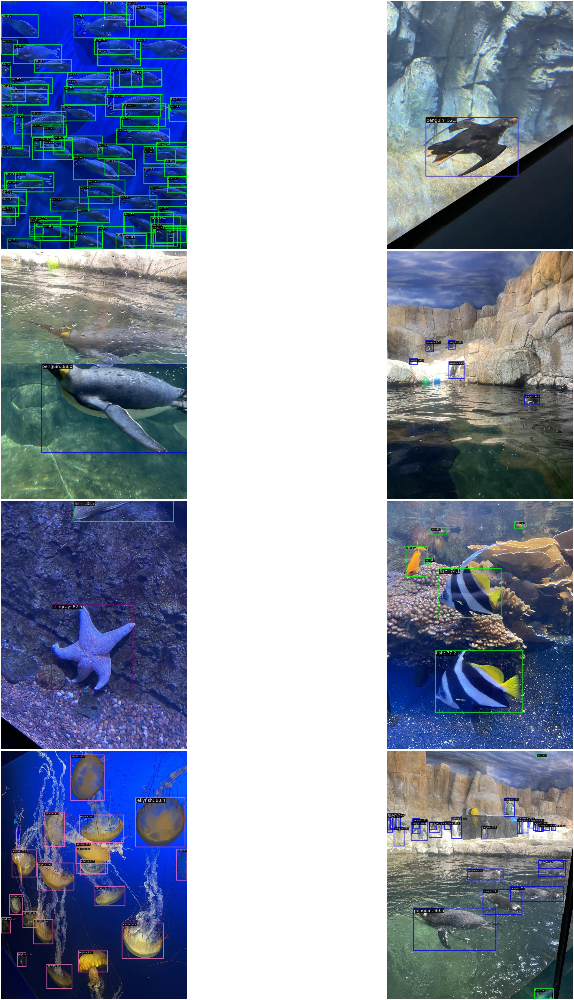

In [5]:
import os
import glob
import matplotlib.pyplot as plt
import cv2  # OpenCV for image loading

# Define the path to the folder containing images
image_folder = 'C:/projects/marine_detection/test_results/rtmdet_tiny_aquarium/vis/'  # Adjust path as needed
image_paths = glob.glob(os.path.join(image_folder, '*.jpg'))  # Adjust the extension if needed


image_paths = image_paths[:8]

# Set up the figure size and layout (5 rows, 4 columns)
fig, axes = plt.subplots(4, 2, figsize=(80,80))  # Adjust size as needed

# Flatten axes array for easy indexing
axes = axes.flatten()

# Loop through images and display them in the grid
for i, img_path in enumerate(image_paths):
    # Load the image using OpenCV
    img = cv2.imread(img_path)
    # Convert the image from BGR (OpenCV format) to RGB (Matplotlib format)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image on the i-th subplot
    axes[i].imshow(img)
    # axes[i].set_title(os.path.basename(img_path))
    axes[i].axis('off')  # Hide axis labels

# Hide any unused subplots if there are fewer than 20 images
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust layout and display the figure
plt.tight_layout()
plt.show()

# REAL-WORLD APPLICATIONS #

1) The model can be used to automatically identify and count different species of fish and other marine organisms in aquariums or natural habitats.

2) By detecting and tracking specific species, the model can be used to study behaviors such as feeding, mating, territoriality, or responses to environmental changes.

3) The model can help in monitoring the health and welfare of marine animals by detecting abnormalities in appearance, behavior, or movement patterns.

4) The model can be integrated into interactive displays or educational apps within aquariums, where visitors can learn about different species by simply pointing their devices at the tanks.